In [1]:
import os
import cv2
import numpy as np
from shutil import copy2
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import normalize
from insightface.app import FaceAnalysis
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering, SpectralClustering, AffinityPropagation
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score
import matplotlib.pyplot as plt

from ultralytics import YOLO

In [2]:
app = FaceAnalysis(name='buffalo_l', providers=['CPUExecutionProvider'])
app.prepare(ctx_id=0)  # use -1 if you face issues with ctx_id

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\det_10g.onnx detection [1, 3, '?', '?'] 127.5 128.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_l\genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: C:\Users\R MOHANAKRISHNAA/.insightface\models\buffalo_

In [3]:
image_folder = 'images'
image_data = []  # to store {img_path, img, faces, embeddings}

for img_name in os.listdir(image_folder):
    img_path = os.path.join(image_folder, img_name)
    img = cv2.imread(img_path)
    if img is None:
        continue

    faces = app.get(img)
    if not faces:
        continue

    embeddings = [face.embedding for face in faces]    
    # Append all info to image_data list
    image_data.append({
        'img_path': img_path,
        'img': img,
        'faces': faces,
        'embeddings': embeddings
    })

print(f"Processed {len(image_data)} images with faces detected and person attributes extracted.")


Processed 29 images with faces detected and person attributes extracted.


In [4]:
# Flatten all embeddings
all_embeddings = []
for data in image_data:
    all_embeddings.extend(data['embeddings'])

X = np.array(all_embeddings)
X_norm = normalize(X, norm="l2")

In [5]:
# Reduce to 50D with PCA only
pca = PCA(n_components=75, random_state=42)
X_pca = pca.fit_transform(X_norm)

# Use X_pca for clustering
X_final = X_pca

print(f"PCA explained variance ratio sum: {pca.explained_variance_ratio_.sum():.2f}")

PCA explained variance ratio sum: 0.84


In [6]:
# Store results for comparison
cluster_algorithms = []

# Agglomerative Clustering
agg = AgglomerativeClustering(n_clusters=20, metric='cosine', linkage='average')
agg_labels = agg.fit_predict(X_final)
agg_silhouette = silhouette_score(X_final, agg_labels, metric='cosine')
cluster_algorithms.append(('Agglomerative', agg_labels, agg_silhouette))


# Spectral Clustering
spec = SpectralClustering(n_clusters=20, affinity='nearest_neighbors', random_state=42)
spec_labels = spec.fit_predict(X_final)
spec_silhouette = silhouette_score(X_final, spec_labels, metric='cosine')
cluster_algorithms.append(('Spectral', spec_labels, spec_silhouette))

# Affinity Propagation (no need to specify k)
aff = AffinityPropagation(random_state=42)
aff_labels = aff.fit_predict(X_final)
aff_silhouette = silhouette_score(X_final, aff_labels, metric='cosine')
cluster_algorithms.append(('AffinityPropagation', aff_labels, aff_silhouette))

# Show results
print("\n=== Clustering Algorithms Comparison ===")
for name, _, score in cluster_algorithms:
    print(f"{name:20s} → Silhouette Score: {score:.3f}")



=== Clustering Algorithms Comparison ===
Agglomerative        → Silhouette Score: 0.285
Spectral             → Silhouette Score: 0.261
AffinityPropagation  → Silhouette Score: 0.374


In [7]:
# Define fine-grained grid of parameters to try
eps_values = np.arange(0.3, 0.6, 0.025)       # eps from 0.3 to 0.575 step 0.025
min_samples_values = range(2, 7)               # min_samples from 2 to 6
metrics = ['cosine']                           # cosine metric usually best for embeddings

results = []

print("=== DBSCAN Hyperparameter Tuning on PCA embeddings ===")

for metric in metrics:
    for eps in eps_values:
        for min_samples in min_samples_values:
            dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric=metric)
            labels = dbscan.fit_predict(X_final)

            n_clusters = len(set(labels)) - (1 if -1 in labels else 0)
            n_outliers = np.sum(labels == -1)

            if n_clusters > 1:
                sil_score = silhouette_score(X_final, labels, metric=metric)
            else:
                sil_score = -1  # invalid silhouette score if <= 1 cluster

            results.append({
                'eps': eps,
                'min_samples': min_samples,
                'metric': metric,
                'silhouette': sil_score,
                'clusters': n_clusters,
                'outliers': n_outliers
            })

            print(f"eps={eps:.3f}, min_samples={min_samples}, metric={metric} → Clusters={n_clusters}, Outliers={n_outliers}, Silhouette={sil_score:.3f}")

# Sort results by silhouette score descending
results_sorted = sorted(results, key=lambda x: x['silhouette'], reverse=True)

print("\n=== Top 5 DBSCAN parameter sets by Silhouette Score ===")
for r in results_sorted[:5]:
    print(r)


=== DBSCAN Hyperparameter Tuning on PCA embeddings ===
eps=0.300, min_samples=2, metric=cosine → Clusters=30, Outliers=93, Silhouette=0.235
eps=0.300, min_samples=3, metric=cosine → Clusters=12, Outliers=129, Silhouette=0.172
eps=0.300, min_samples=4, metric=cosine → Clusters=8, Outliers=141, Silhouette=0.148
eps=0.300, min_samples=5, metric=cosine → Clusters=6, Outliers=149, Silhouette=0.140
eps=0.300, min_samples=6, metric=cosine → Clusters=5, Outliers=156, Silhouette=0.124
eps=0.325, min_samples=2, metric=cosine → Clusters=32, Outliers=85, Silhouette=0.265
eps=0.325, min_samples=3, metric=cosine → Clusters=12, Outliers=125, Silhouette=0.190
eps=0.325, min_samples=4, metric=cosine → Clusters=8, Outliers=137, Silhouette=0.166
eps=0.325, min_samples=5, metric=cosine → Clusters=7, Outliers=141, Silhouette=0.166
eps=0.325, min_samples=6, metric=cosine → Clusters=5, Outliers=153, Silhouette=0.142
eps=0.350, min_samples=2, metric=cosine → Clusters=29, Outliers=81, Silhouette=0.317
eps=0.35

eps=0.550, min_samples=5, metric=cosine → Clusters=10, Outliers=110, Silhouette=0.222
eps=0.550, min_samples=6, metric=cosine → Clusters=7, Outliers=125, Silhouette=0.188
eps=0.575, min_samples=2, metric=cosine → Clusters=30, Outliers=44, Silhouette=0.335
eps=0.575, min_samples=3, metric=cosine → Clusters=18, Outliers=68, Silhouette=0.281
eps=0.575, min_samples=4, metric=cosine → Clusters=16, Outliers=81, Silhouette=0.244
eps=0.575, min_samples=5, metric=cosine → Clusters=11, Outliers=104, Silhouette=0.232
eps=0.575, min_samples=6, metric=cosine → Clusters=7, Outliers=124, Silhouette=0.187

=== Top 5 DBSCAN parameter sets by Silhouette Score ===
{'eps': np.float64(0.5250000000000001), 'min_samples': 2, 'metric': 'cosine', 'silhouette': 0.3765687942504883, 'clusters': 30, 'outliers': np.int64(55)}
{'eps': np.float64(0.5000000000000002), 'min_samples': 2, 'metric': 'cosine', 'silhouette': 0.3726302981376648, 'clusters': 31, 'outliers': np.int64(56)}
{'eps': np.float64(0.47500000000000014

In [8]:
# Add best DBSCAN result to algorithm comparison
best_dbscan_result = results_sorted[0]
dbscan = DBSCAN(
    eps=best_dbscan_result['eps'],
    min_samples=best_dbscan_result['min_samples'],
    metric=best_dbscan_result['metric']
)
dbscan_labels = dbscan.fit_predict(X_final)
dbscan_sil = silhouette_score(X_final, dbscan_labels, metric='cosine')

cluster_algorithms.append(('DBSCAN', dbscan_labels, dbscan_sil))


# Pick the algorithm with the highest silhouette score
best_name, best_labels, best_score = max(cluster_algorithms, key=lambda x: x[2])
print(f"\n✅ Using {best_name} clustering with silhouette score {best_score:.3f}")

# Use best labels in the rest of the pipeline
labels = best_labels


✅ Using DBSCAN clustering with silhouette score 0.377


In [9]:
# Filter out outliers (e.g., label = -1)
valid_mask = labels != -1
X_valid = X_final[valid_mask]
labels_valid = labels[valid_mask]

# Only compute if more than 1 cluster remains
if len(set(labels_valid)) > 1:
    dbi = davies_bouldin_score(X_valid, labels_valid)
    chi = calinski_harabasz_score(X_valid, labels_valid)

    print("\n📊 Quantitative Evaluation Metrics:")
    print(f"Silhouette Score:         {best_score:.3f}")
    print(f"Davies-Bouldin Index:     {dbi:.3f}  (lower is better)")
    print(f"Calinski-Harabasz Index:  {chi:.3f}  (higher is better)")
else:
    print("\n⚠️ Not enough valid clusters to compute DBI/CHI.")



📊 Quantitative Evaluation Metrics:
Silhouette Score:         0.377
Davies-Bouldin Index:     1.114  (lower is better)
Calinski-Harabasz Index:  10.388  (higher is better)


In [10]:
idx = 0
for data in image_data:
    n = len(data['embeddings'])
    data['labels'] = labels[idx:idx+n]
    idx += n

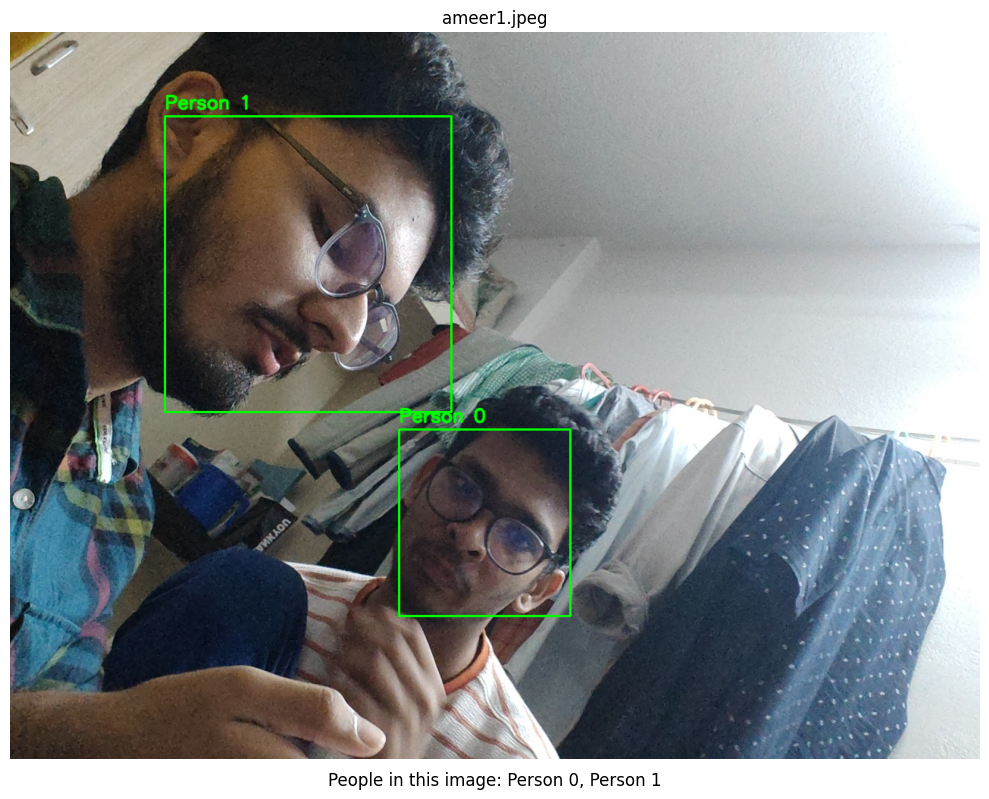

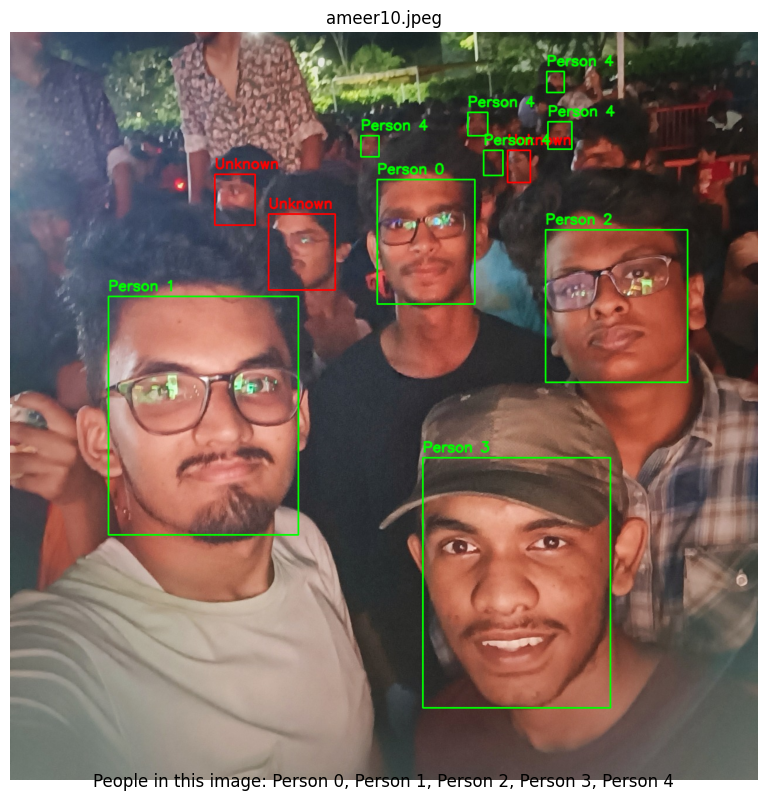

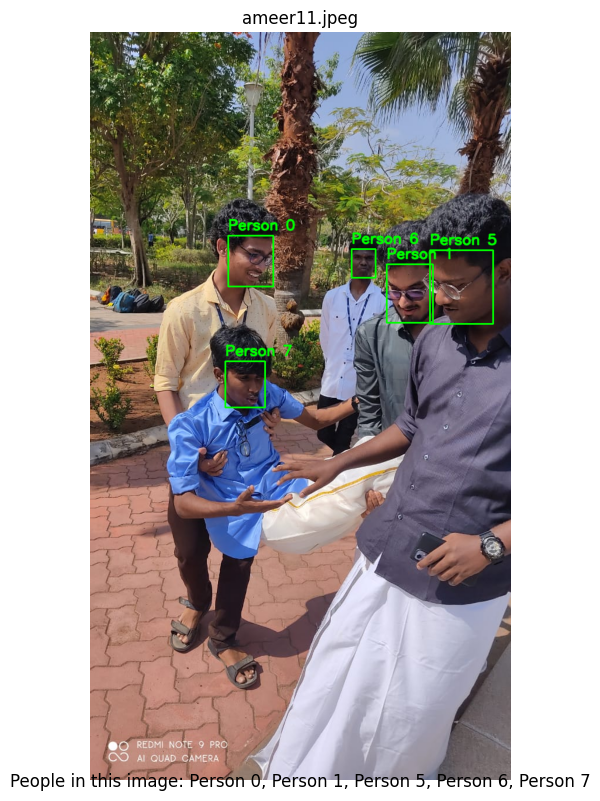

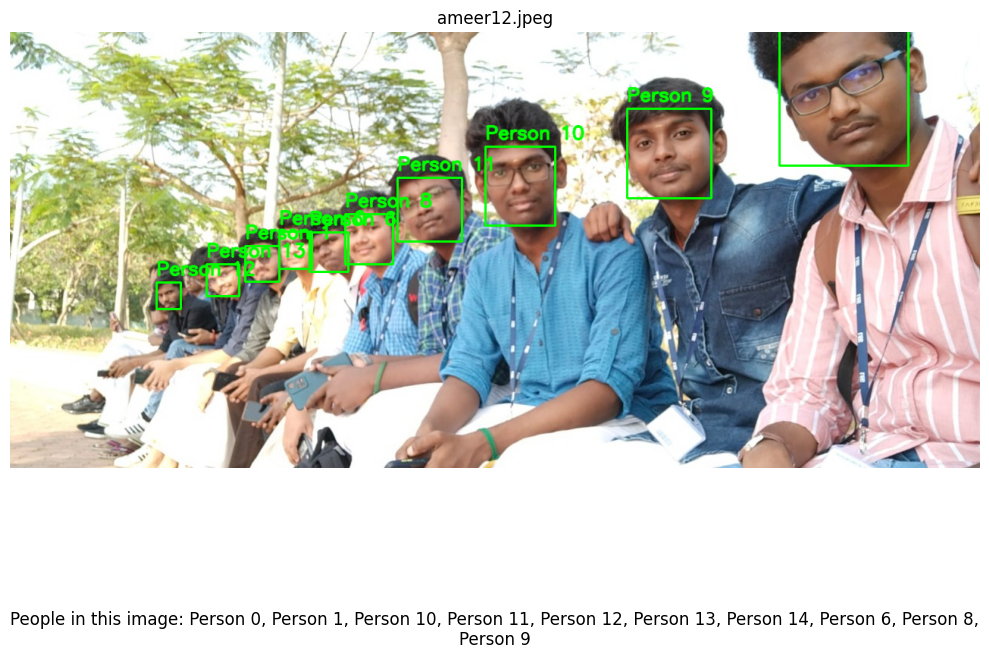

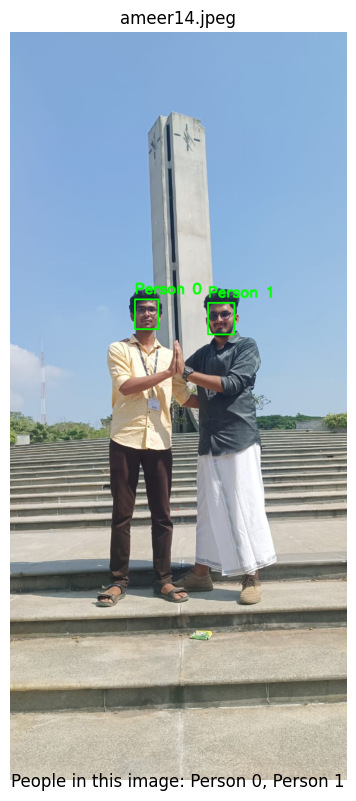

...

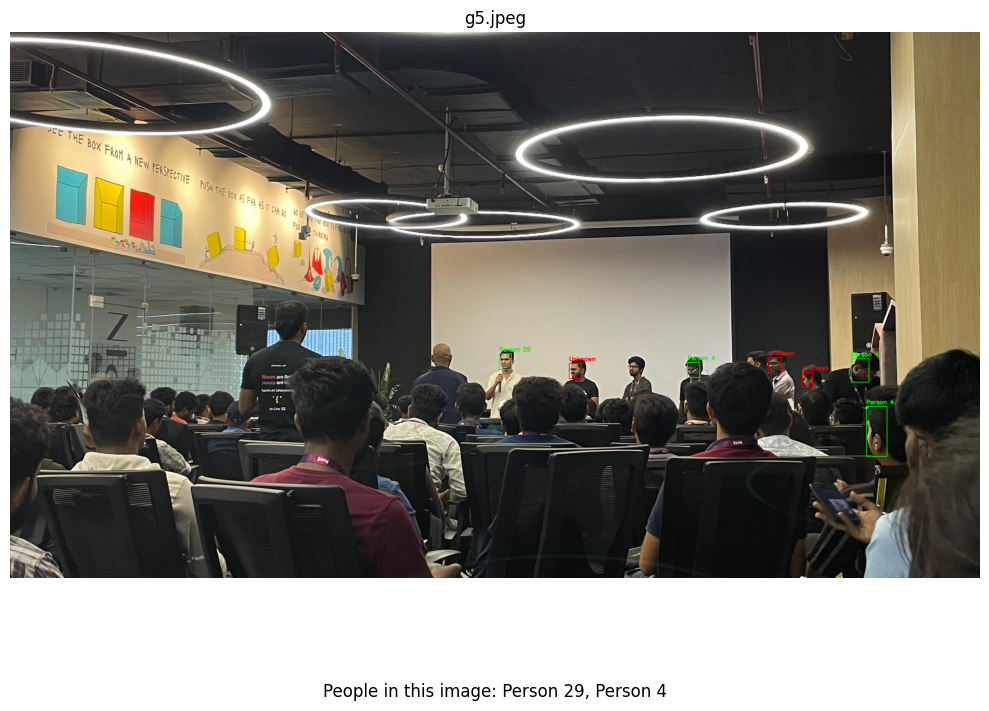

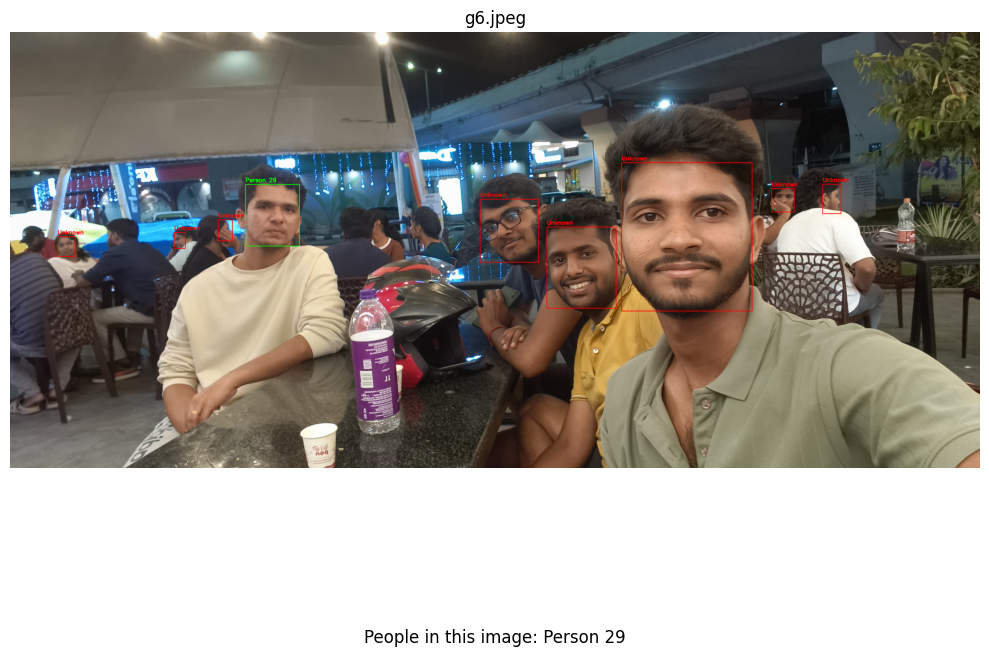

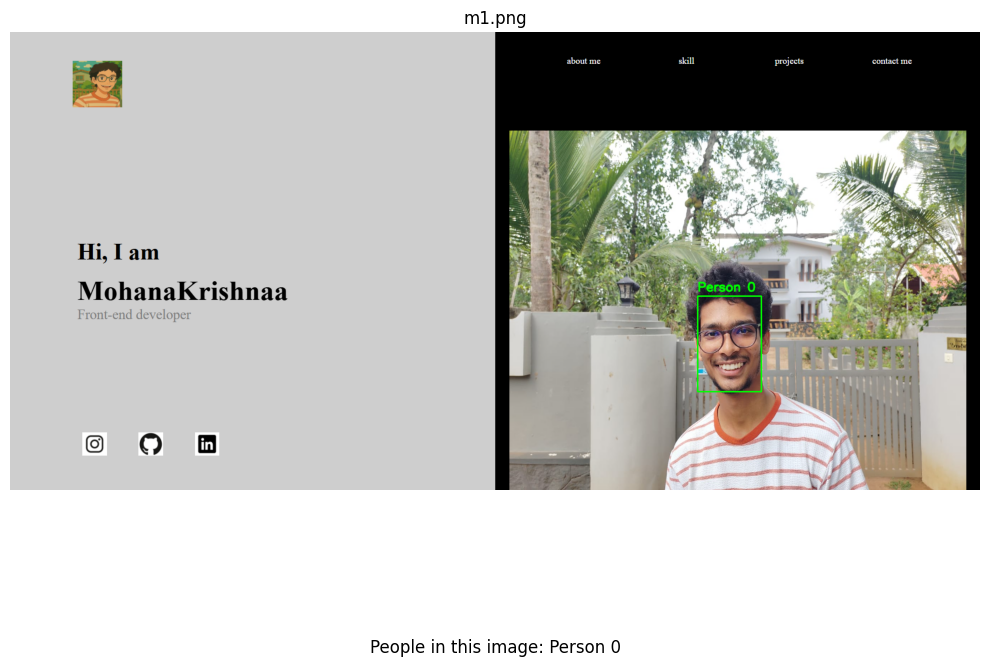

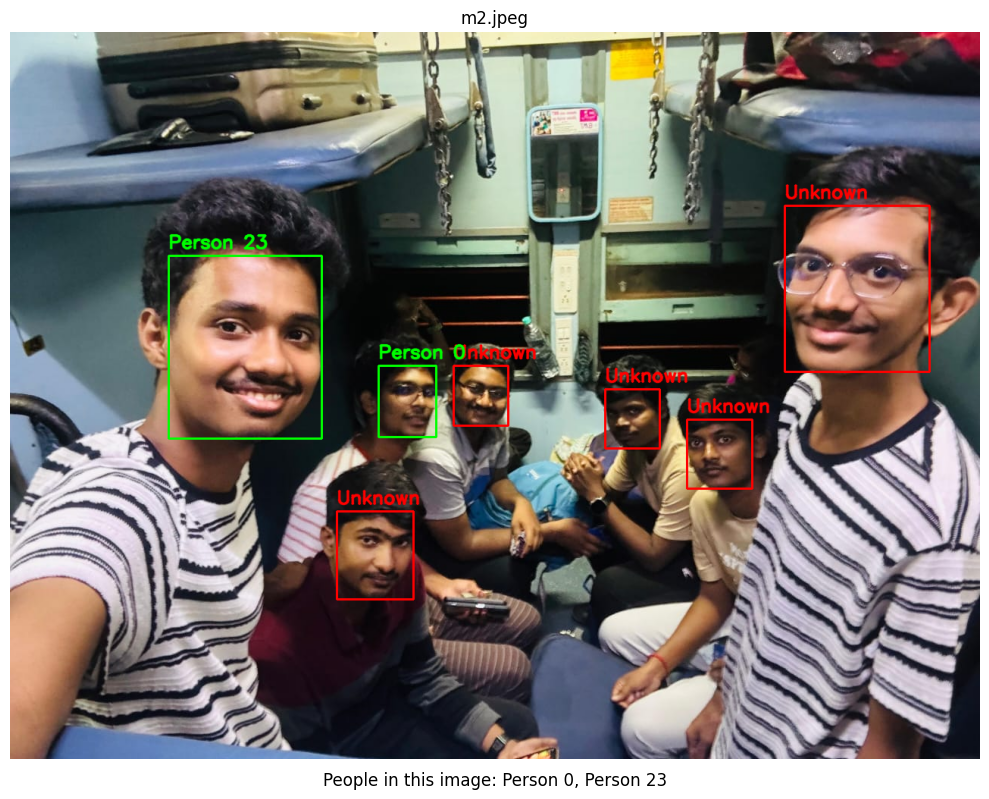

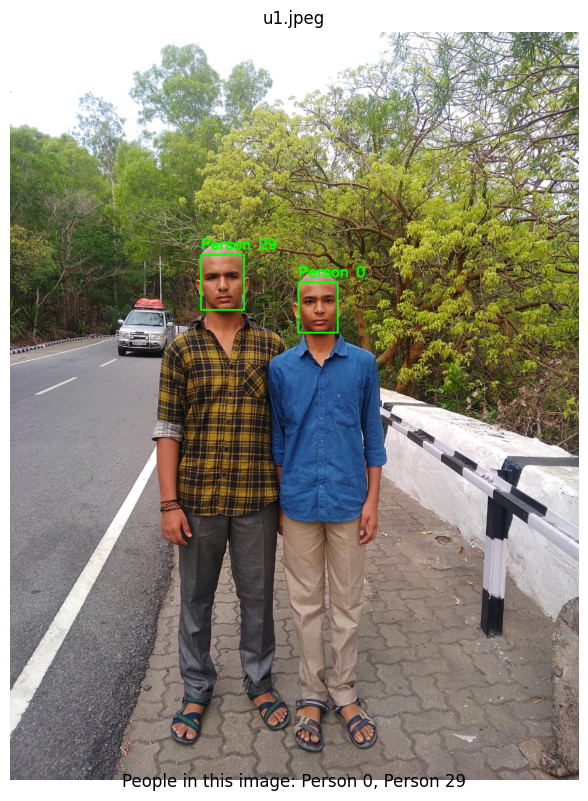

In [11]:
def draw_faces(img, faces, labels):
    img_disp = img.copy()
    for face, label in zip(faces, labels):
        bbox = face.bbox.astype(int)
        x1, y1, x2, y2 = bbox[0], bbox[1], bbox[2], bbox[3]

        # Color & text
        color = (0, 255, 0) if label != -1 else (0, 0, 255)
        text = f"Person {label}" if label != -1 else "Unknown"

        # Draw box
        cv2.rectangle(img_disp, (x1, y1), (x2, y2), color, 2)
        cv2.putText(img_disp, text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX,
                    0.8, color, 2, cv2.LINE_AA)
    return img_disp

# Display labeled faces
for data in image_data:
    img_labeled = draw_faces(data['img'], data['faces'], data['labels'])

    persons_in_img = sorted(set(f"Person {label}" for label in data['labels'] if label != -1))
    persons_text = "People in this image: " + (", ".join(persons_in_img) if persons_in_img else "Unknown")

    plt.figure(figsize=(10, 8))
    plt.imshow(cv2.cvtColor(img_labeled, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.title(os.path.basename(data['img_path']))
    plt.figtext(0.5, 0.01, persons_text, ha="center", fontsize=12, wrap=True)
    plt.tight_layout()
    plt.show()

In [12]:
person_to_images = {}

for data in image_data:
    for label in data['labels']:
        if label == -1:
            continue
        person_key = f"Person {label}"
        if person_key not in person_to_images:
            person_to_images[person_key] = []
        if data['img_path'] not in person_to_images[person_key]:
            person_to_images[person_key].append(data['img_path'])

# Print the dictionary
for key, value in person_to_images.items():
    print(f"{key} - {value}")

Person 0 - ['images\\ameer1.jpeg', 'images\\ameer10.jpeg', 'images\\ameer11.jpeg', 'images\\ameer12.jpeg', 'images\\ameer14.jpeg', 'images\\ameer15.jpeg', 'images\\ameer16.jpeg', 'images\\ameer18.jpeg', 'images\\ameer19.jpeg', 'images\\ameer2.jpeg', 'images\\ameer20.jpeg', 'images\\ameer21.jpeg', 'images\\ameer22.jpeg', 'images\\ameer23.jpeg', 'images\\ameer24.jpeg', 'images\\ameer25.jpeg', 'images\\ameer26.jpeg', 'images\\ameer6.jpeg', 'images\\ameer8.jpeg', 'images\\ameer9.jpeg', 'images\\m1.png', 'images\\m2.jpeg', 'images\\u1.jpeg']
Person 1 - ['images\\ameer1.jpeg', 'images\\ameer10.jpeg', 'images\\ameer11.jpeg', 'images\\ameer12.jpeg', 'images\\ameer14.jpeg', 'images\\ameer15.jpeg', 'images\\ameer16.jpeg', 'images\\ameer18.jpeg', 'images\\ameer19.jpeg', 'images\\ameer2.jpeg', 'images\\ameer20.jpeg', 'images\\ameer21.jpeg', 'images\\ameer22.jpeg', 'images\\ameer23.jpeg', 'images\\ameer24.jpeg', 'images\\ameer25.jpeg', 'images\\ameer26.jpeg', 'images\\ameer6.jpeg', 'images\\ameer8.

In [13]:
from sklearn.metrics.pairwise import cosine_similarity

def display_matched_images(query_img_path, image_data, X_final, labels, threshold=0.55, top_k=20):
    """
    Given a query image, find and display all dataset images where the same person appears,
    sorted by similarity with similarity score shown.
    """

    query_img = cv2.imread(query_img_path)
    if query_img is None:
        print("❌ Failed to load query image.")
        return

    query_faces = app.get(query_img)
    if not query_faces:
        print("❌ No face detected in the query image.")
        return

    query_embedding = query_faces[0].embedding.reshape(1, -1)
    query_embedding_norm = normalize(query_embedding, norm="l2")
    query_pca = pca.transform(query_embedding_norm)

    # Similarity with all embeddings
    similarities = cosine_similarity(query_pca, X_final)[0]

    # Get sorted indices by similarity
    sorted_indices = np.argsort(similarities)[::-1]  # descending order

    matched_info = []
    used_paths = set()

    for idx in sorted_indices:
        sim = similarities[idx]
        if sim < threshold:
            break  # stop if below threshold

        label = labels[idx]

        # Find the image that contains this label
        for data in image_data:
            if data['img_path'] in used_paths:
                continue
            if label in data['labels']:
                matched_info.append((data['img_path'], sim))
                used_paths.add(data['img_path'])
                break  # move to next idx

        if len(matched_info) >= top_k:
            break

    if not matched_info:
        print("⚠️ No sufficiently similar faces found.")
        return

    # Display the images
    cols = 4
    rows = (len(matched_info) + cols - 1) // cols
    plt.figure(figsize=(16, 4 * rows))

    for i, (img_path, sim) in enumerate(matched_info):
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.subplot(rows, cols, i + 1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Similarity: {sim*100:.2f}%\n{os.path.basename(img_path)}", fontsize=10)

    plt.tight_layout()
    plt.show()

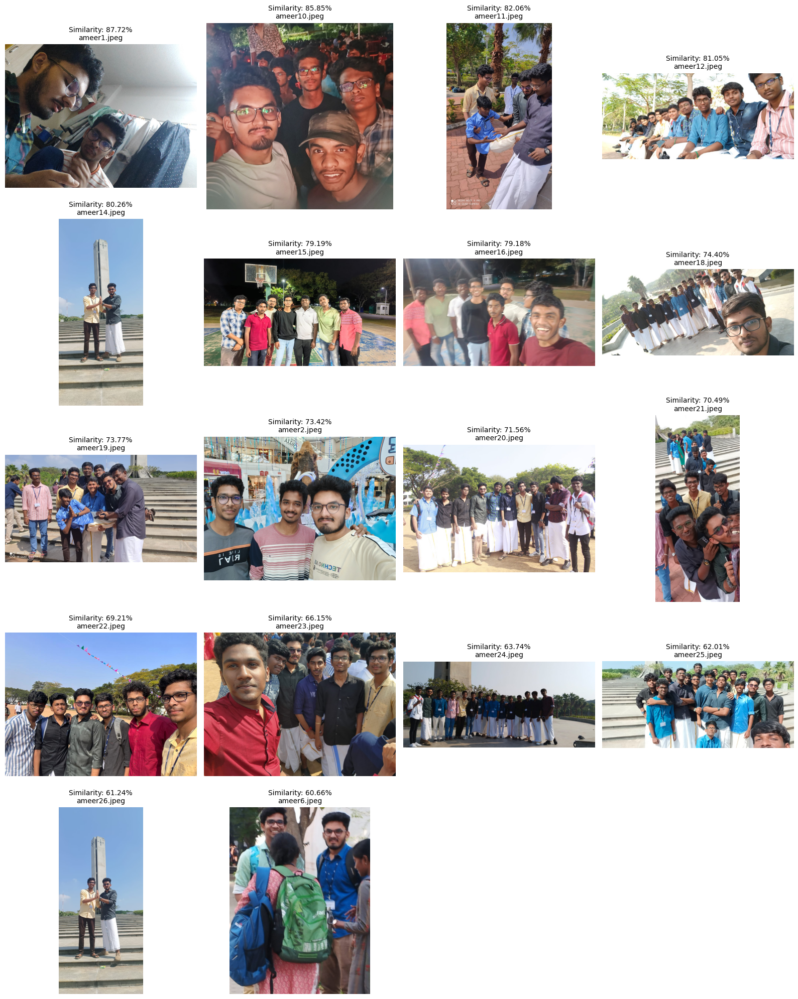

In [14]:
query_image_path = "test5.jpeg"  # Replace with your input
display_matched_images(query_image_path, image_data, X_final, labels, threshold=0.55)